In [2]:
!pip install -U kaleido

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import os

In [2]:
src_file = os.path.join('data', 'raw', 'EPA_fuel_economy_summary.csv')
image_dir = ('images')

In [3]:
df = pd.read_csv(src_file)
df.head()

,make,model,year,transmission,drive,date_range,fuel_type_summary,class_summary,cylinders,displ,co2,barrels08,fuelCost08,highway08,city08,comb08
0,Acura,NSX,2000,Automatic,2WD,2000-2010,Gas,Car,6.0,3.0,-1,18.311667,2600,22,15,18
1,Acura,NSX,2000,Manual,2WD,2000-2010,Gas,Car,6.0,3.2,-1,18.311667,2600,22,15,18
2,BMW,M Coupe,2000,Manual,2WD,2000-2010,Gas,Car,6.0,3.2,-1,17.347895,2500,23,17,19
3,BMW,Z3 Coupe,2000,Automatic,2WD,2000-2010,Gas,Car,6.0,2.8,-1,17.347895,2500,24,17,19
4,BMW,Z3 Coupe,2000,Manual,2WD,2000-2010,Gas,Car,6.0,2.8,-1,17.347895,2500,24,17,19


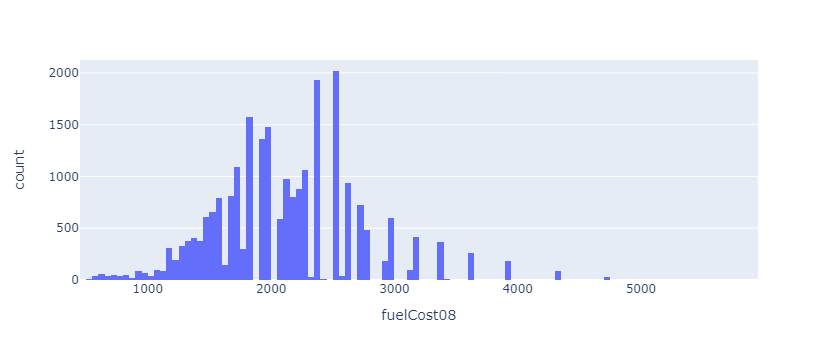

In [4]:
fig = px.histogram(df, x="fuelCost08")
fig.show()

In [ ]:
fig.write_image("plotlyhistogram.svg", engine="kaleido")

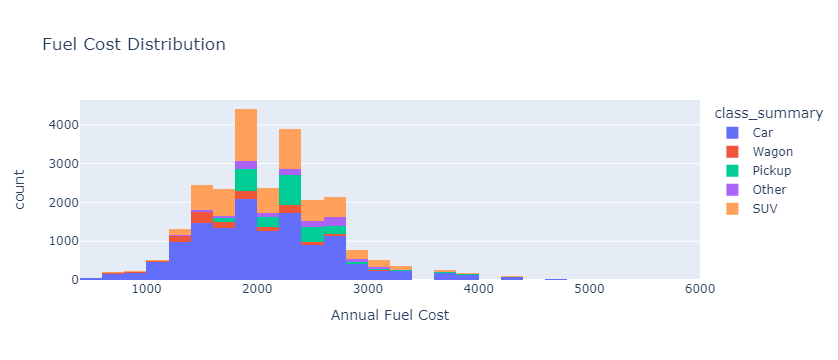

In [19]:
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    labels={"fuelCost08": "Annual Fuel Cost"},
    nbins=40,
    title="Fuel Cost Distribution",
)
fig.show()

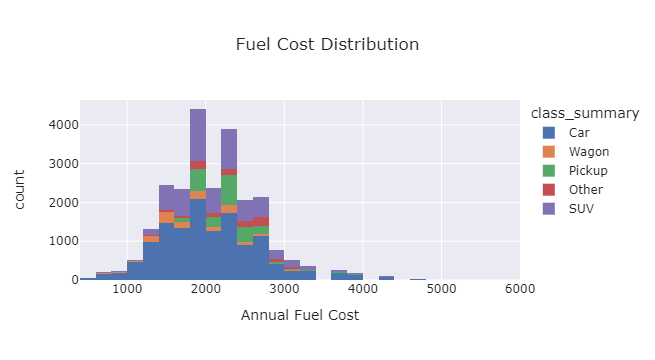

In [20]:
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    labels={"fuelCost08": "Annual Fuel Cost"},
    template="seaborn",
    nbins=40,
    title="Fuel Cost Distribution",
)
fig.show()


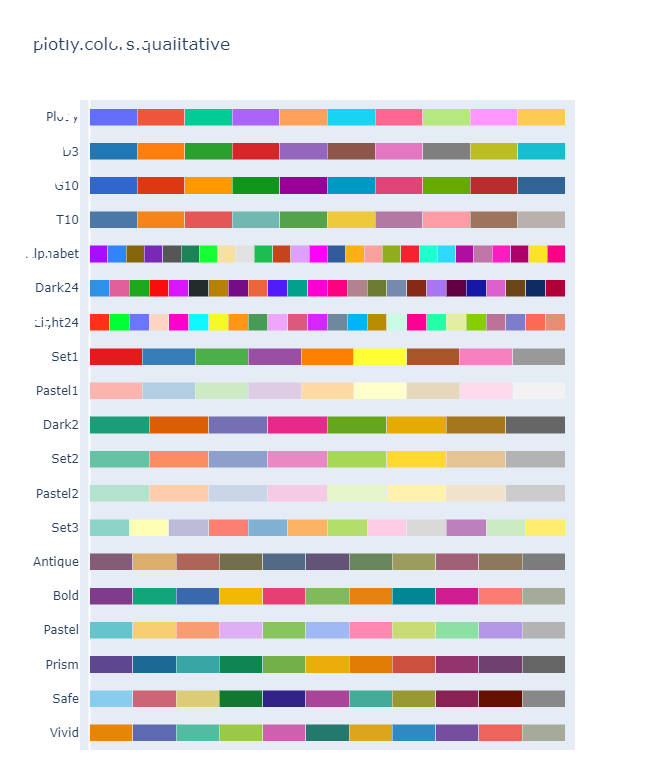

In [21]:
fig = px.colors.qualitative.swatches()
fig.show()

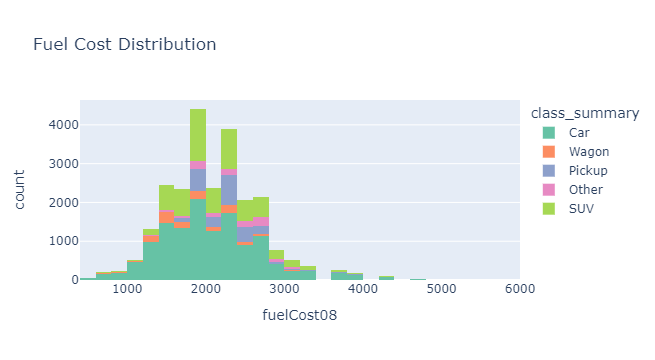

In [22]:
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    nbins=40,
    title="Fuel Cost Distribution",
    color_discrete_sequence=px.colors.qualitative.Set2,
)
fig.show()

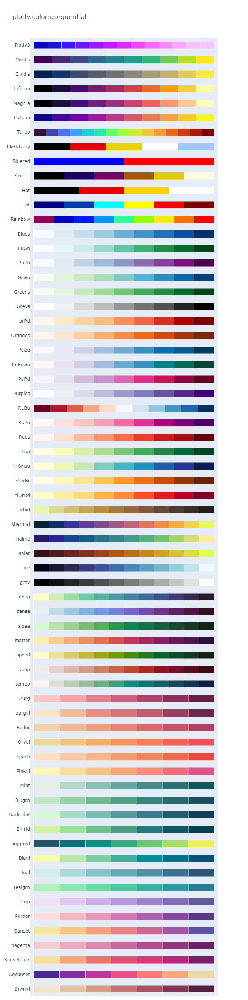

In [23]:
fig = px.colors.sequential.swatches()
fig.show()

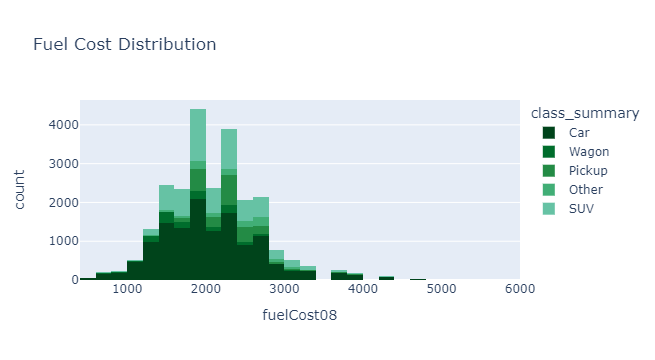

In [24]:
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    nbins=40,
    title="Fuel Cost Distribution",
    color_discrete_sequence=px.colors.sequential.BuGn_r,
)
fig.show()

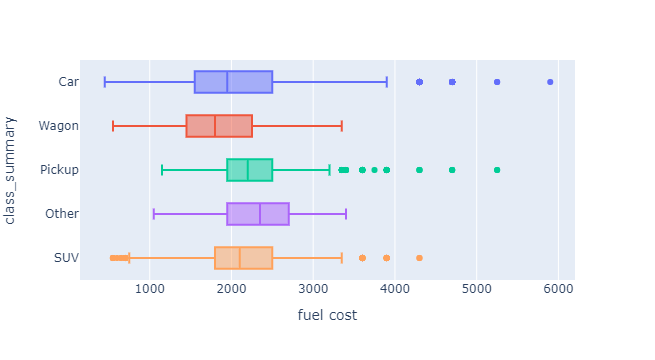

In [25]:
fig = px.box(
    df,
    x="fuelCost08",
    y="class_summary",
    color="class_summary",
    labels={"fuelCost08":"fuel cost"},
)
fig.update_layout(showlegend=False)
fig.show()

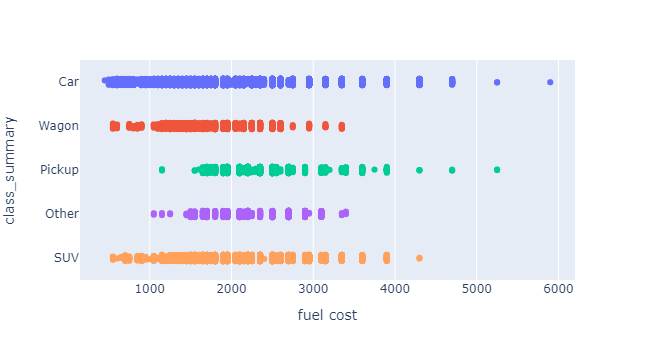

In [26]:
fig = px.strip(
    df,
    x="fuelCost08",
    y="class_summary",
    color="class_summary",
    labels=dict(fuelCost08="fuel cost"),
)
fig.update_layout(showlegend=False)
fig.show()


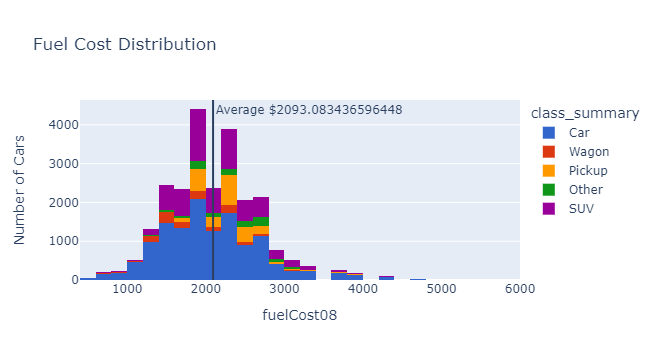

In [28]:
avg_cost = df["fuelCost08"].mean()
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    nbins=40,
    title="Fuel Cost Distribution",
    color_discrete_sequence=px.colors.qualitative.G10,
)
fig.update_yaxes(title_text="Number of Cars")
fig.add_vline(x=avg_cost, annotation_text=f"Average ${avg_cost}")
fig.show()

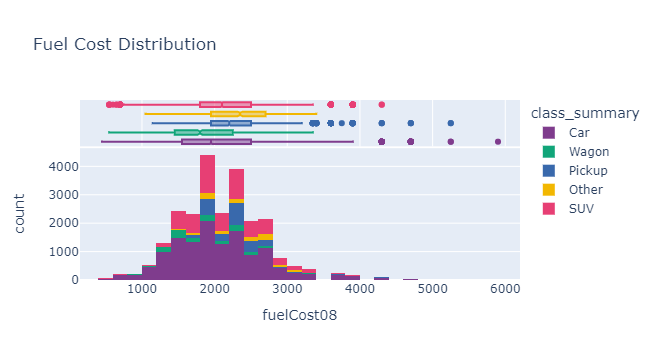

In [29]:
fig = px.histogram(
    df,
    x="fuelCost08",
    color="class_summary",
    nbins=40,
    title="Fuel Cost Distribution",
    marginal="box",
    color_discrete_sequence=px.colors.qualitative.Bold,
)
fig.show()


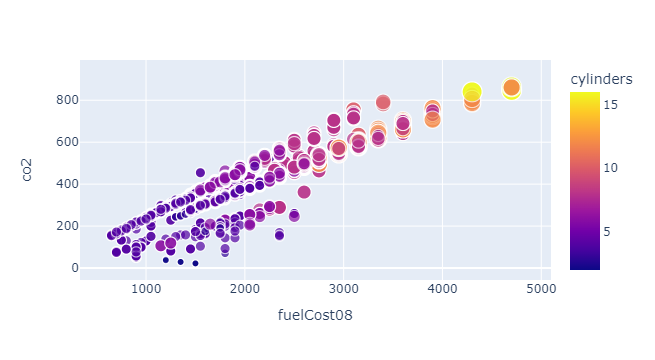

In [30]:
fig = px.scatter(
    df.query("co2 > 0"),
    x="fuelCost08",
    y="co2",
    hover_name="model",
    size="cylinders",
    color="cylinders",
    hover_data=["make", "year", "cylinders"],
)
fig.show()

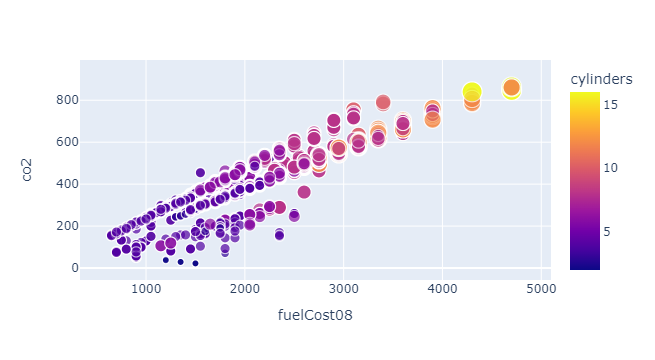

In [31]:
fig = px.scatter(
    df.query("co2 > 0"),
    x="fuelCost08",
    y="co2",
    hover_name="model",
    size="cylinders",
    color="cylinders",
    hover_data={"make": True, "year": True, "cylinders": ":.0f", "fuelCost08": ":$.0f"},
)
fig.show()

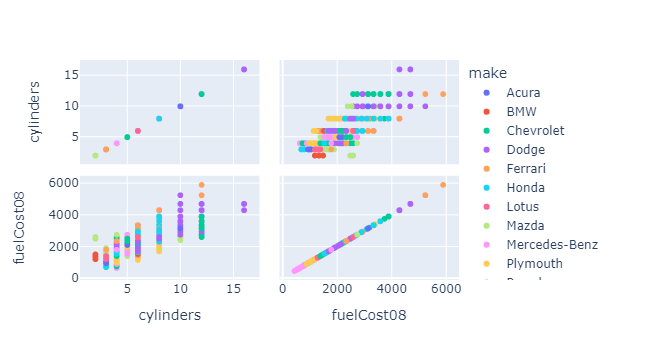

In [32]:
fig = px.scatter_matrix(df, dimensions=["cylinders", "fuelCost08"], color="make")
fig.show()

In [36]:
avg_by_year = df.groupby(["year"], as_index=False).agg({"fuelCost08": "mean"}).round(2)
avg_by_year

,year,fuelCost08
0,2000,2184.94
1,2001,2201.48
2,2002,2229.38
3,2003,2273.99
4,2004,2264.57
5,2005,2271.01
6,2006,2287.00
7,2007,2284.15
8,2008,2285.68
9,2009,2183.23


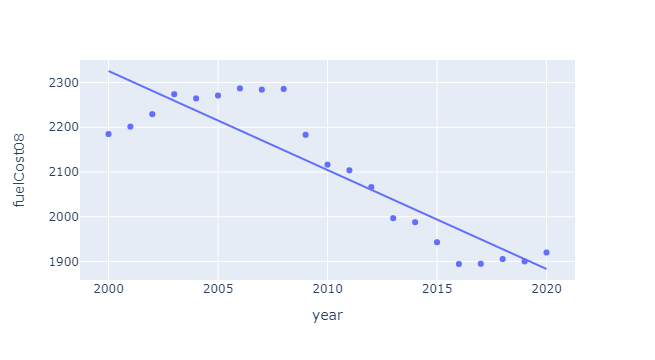

In [37]:
fig = px.scatter(avg_by_year, x="year", y="fuelCost08", trendline="ols")
fig.show()

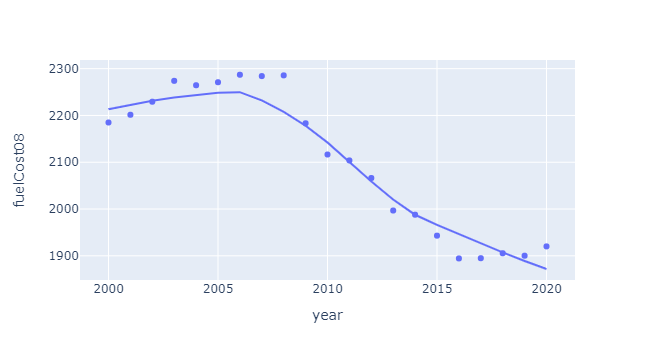

In [38]:
fig = px.scatter(avg_by_year, x="year", y="fuelCost08", trendline="lowess")
fig.show()


C:\ProgramData\Anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\ProgramData\Anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



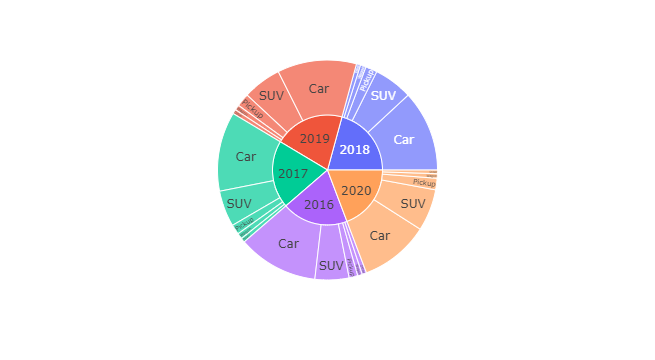

In [43]:
fig = px.sunburst(
    df.query("year > 2015"),
    path=["year", "class_summary"]
)
fig.show()

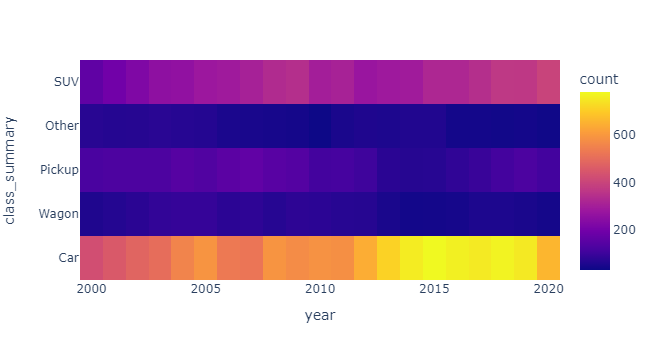

In [44]:
fig = px.density_heatmap(df, x="year", y="class_summary")
fig.show()

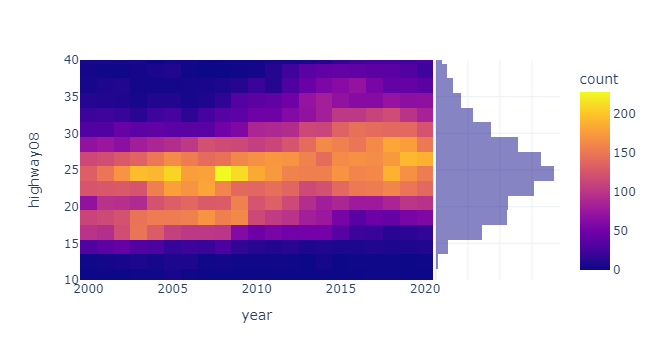

In [45]:
fig = px.density_heatmap(
    df,
    x="year",
    y="highway08",
    marginal_y="histogram",
    template="plotly_white",
    range_y=[10, 40],
)
fig.show()


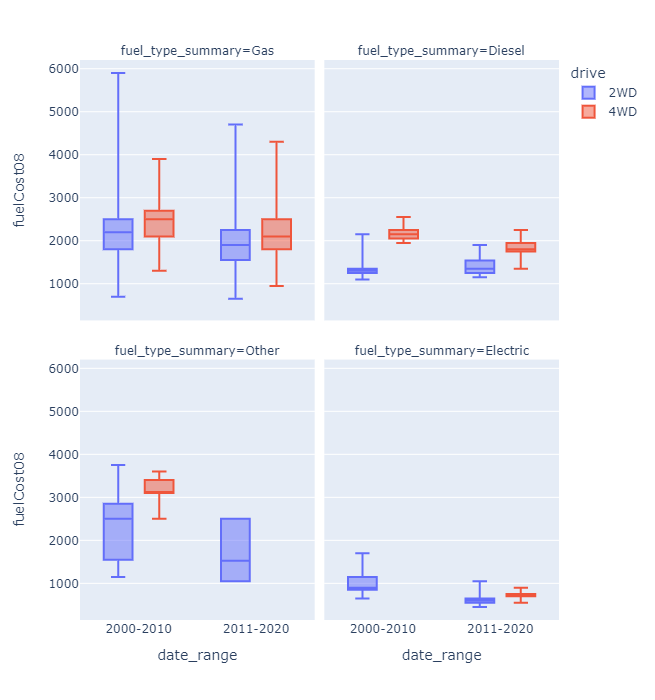

In [46]:
fig = px.box(
    df,
    x="date_range",
    y="fuelCost08",
    facet_col="fuel_type_summary",
    facet_col_wrap=2,
    boxmode="group",
    color="drive",
    points=False,
    height=700,
)

fig.show()

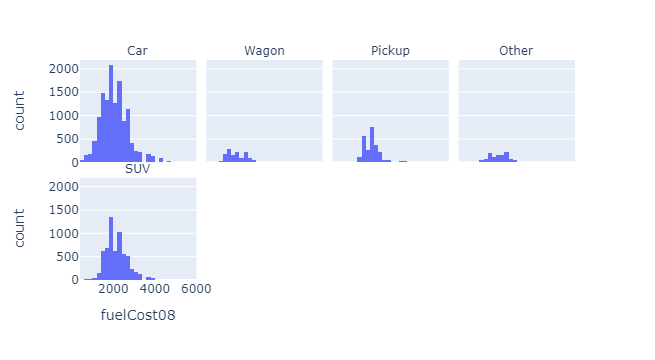

In [49]:
fig = px.histogram(
    df, x="fuelCost08", facet_col="class_summary", facet_col_wrap=4, nbins=40
)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

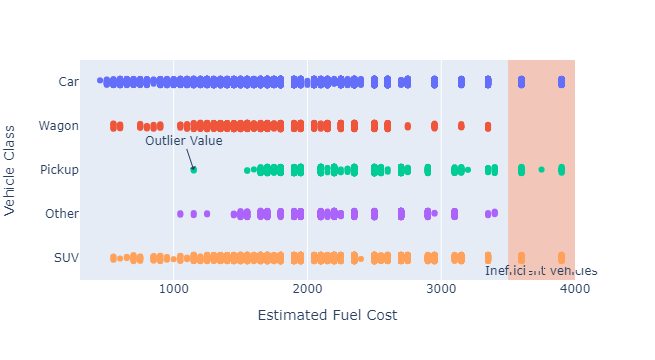

In [ ]:
fig = px.strip(
    df, x="fuelCost08", y="class_summary", color="class_summary", range_x=[300, 4000]
)
fig.update_layout(showlegend=False)
fig.update_yaxes(title="Vehicle Class")
fig.update_xaxes(title="Estimated Fuel Cost")
fig.add_annotation(
    x=1150, y="Pickup", text="Outlier Value", showarrow=True, arrowhead=1
)
fig.add_vrect(
    x0=3500,
    x1=4000,
    fillcolor="LightSalmon",
    opacity=0.5,
    layer="below",
    line_width=0,
    annotation_text="Inefficient vehicles",
    annotation_position="bottom",
)
fig.show()

In [52]:
# Masoud Kaviani